In [1]:
using LinearAlgebra
using DiffEqBase
using OrdinaryDiffEq: SplitODEProblem, solve, IMEXEuler, KenCarp4, Tsit5, Rosenbrock23, SBDF2
import SciMLBase
using Plots
using Statistics


In [90]:
function run_simulation(t_total, pulsing_period, duty_cycle; T_hot, T_cold, Δt, Tegg_init=20, n_cells=50, 
    scaler=0.37, # TODO: why???
    scaler_asym = 1 # TODO: why???
    )

    ρ_yolk = T -> 1037.3 - 0.1386 * (T) - 0.0023*(T)^2   # kg/m^3
    ρ_albumen = T -> 1043.3 - 0.0115 * (T) - 0.0041*(T)^2  # kg/m^3
    c_p_yolk = 3120  # J/(kg·°C)
    c_p_albumen = 3800  # J/(kg·°C)
    k_yolk = T -> 0.0008*(T) + 0.395 #0.5  # W/(m·°C)
    k_albumen = T -> 0.0013*(T) + 0.5125 #0.6  # W/(m·°C)

    # renormalize for egg lengthscales
    # 62mm	43mm
    egg_diameter = scaler*6e-2 #0.5*0.55*43e-3 # 43mm
    yolk_diameter = scaler*2*1.75e-2 # radius 1.5cm # TODO: better agrement when 2 dropped???

    α_yolk = T -> k_yolk(T) / (ρ_yolk(T) * c_p_yolk * (scaler_asym*egg_diameter)^2) # m^2/s
    α_albumen = T -> k_albumen(T) / (ρ_albumen(T) * c_p_albumen * egg_diameter^2) # m^2/s

    function dynamic_alpha_vec(Tvec; n, n_yolk)

        T = clamp.(Tvec, 0, 200)

        α_vec = α_albumen.(T) #[α_albumen(T) for t in T]
        ishift_test = 1
        i1, i2 = ishift_test + 1 + div(n - 1, 2) - div(n_yolk, 2), ishift_test + 1 + div(n - 1, 2) + div(n_yolk, 2)
        α_vec[i1:i2] .= α_yolk.(T[i1:i2])
        α_vec
    end

    FT = Float64; # float type

    a, b, n = 0, 1, n_cells   # zmin, zmax
    n_yolk = Integer(round(yolk_diameter*n_cells/egg_diameter)) #11
    # n̂_min, n̂_max = -1, 1  # Outward facing unit vectors
    β, γ = 0, π;  # source term coefficients
    N_t = Integer(ceil(t_total / Δt));  # number of timesteps to take
    
    Δz = FT(b - a) / FT(n)
    Δz² = Δz^2;
    ∇²_op = [1 / Δz², -2 / Δz², 1 / Δz²];  # interior Laplacian operator

    S(z) = β * sin(γ * z)               # source term, (sin for easy integration)
    zf = range(a, b, length = n + 1);   # coordinates on cell faces

    # pulsing_period = 2*60;

    # α_vec = [α_albumen(80) for i in 1:n+1]
    # α_vec[1 + div(n - 1, 2) - div(n_yolk, 2):1 + div(n - 1, 2) + div(n_yolk, 2)] .= α_yolk(80)

    α_vec = dynamic_alpha_vec(ones(n+1)*80; n=n, n_yolk=n_yolk)

    # plot(α_vec, marker="o")

    # Initialize interior and boundary stencils:
    ∇² = Tridiagonal(ones(FT, n) .* ∇²_op[1],
    ones(FT, n + 1) .* ∇²_op[2],
    ones(FT, n) .* ∇²_op[3]);

    # Modify boundary stencil to account for BCs

    ∇².du[1] = 0  # modified stencil
    ∇².d[1] = 0 # to ensure `∂_t T = 0` at `z=0`
    ∇².dl[1] = 0  # to ensure `∂_t T = 0` at `z=0`

    ∇².du[n] = 0  # modified stencil
    ∇².d[n + 1] = 0 # to ensure `∂_t T = 0` at `z=zmax`
    ∇².dl[n] = 0  # to ensure `∂_t T = 0` at `z=zmax`

    # Calculate 
    D = α_vec .* ∇²

    T0 = zeros(FT, n + 1);
    T0 .= Tegg_init; 
    T0[1] = T_hot; # set top BC
    T0[n + 1] = T_hot; # set top BC

    function temp_from_thermal_state(thermal_state)
        if thermal_state == 0
            return T_hot
        else
            return T_cold
        end
    end
    
    function condition(u, t, integrator)
        # mod(t, pulsing_period) == 0
        cycle_position = mod(t, pulsing_period)
        cycle_on_time = pulsing_period * duty_cycle
        
        (cycle_position == cycle_on_time) || (cycle_position == 0)
    end
    
    function affect!(integrator)
        n = integrator.p[1]
        n_yolk = integrator.p[2]
        thermal_state = mod(integrator.p[3] + 1, 2)
        integrator.p = (; n=n, n_yolk=n_yolk, thermal_state=thermal_state)
    
        T = temp_from_thermal_state(thermal_state)
    
        integrator.u[1] = T
        integrator.u[2] = T
        integrator.u[n] = T
        integrator.u[n+1] = T
    end

    @assert duty_cycle >= 0 && duty_cycle < 0.99
    
    if duty_cycle >= 0.01
        cb = DiscreteCallback(condition, affect!)
        opts = Dict(:callback => cb, :tstops => (0:pulsing_period * duty_cycle:N_t * FT(Δt)))
    else
        opts = Dict(:callback => nothing)
    end

    function rhs!(dT, T, params, t)
        n = params.n
        i = 1:n # interior domain
        
        source_temp = temp_from_thermal_state(params.thermal_state);
        AT_b = source_temp / Δz²;
        
        dT .= 0
        dT[2] = α_albumen(T[2]) * AT_b 
        dT[n] = α_albumen(T[n]) * AT_b

        dT
    end

    params = (; n, n_yolk, thermal_state=0.)

    tspan = (FT(0), N_t * FT(Δt))

    function update_func!(A, u, p, t)
        # @show u[20]
        A .= dynamic_alpha_vec(u; n_yolk=p.n_yolk, n=p.n) .* ∇²
        A
    end

    prob = SplitODEProblem(SciMLBase.DiffEqArrayOperator(D; update_func=update_func!),
        rhs!,
        T0,
        tspan,
        params)
    alg = SBDF2(autodiff=false); #IMEXEuler(autodiff=false);
    # println("Solving...")
    sol = solve(prob,
        alg;
        dt = Δt,
        saveat = range(FT(0), N_t * FT(Δt), length = N_t),
        # callback = cb,
        progress = true,
        progress_message = (dt, u, p, t) -> t,
        opts...
        # tstops = (duty_cycle != 0) ? (0:pulsing_period * duty_cycle:N_t * FT(Δt)) : nothing,
    )

end

run_simulation (generic function with 1 method)

In [100]:
function run_simulation_steps(t_total, pulsing_period, pulse_sequence; Δt, Tegg_init=20, n_cells=50, 
    scaler=0.37, # TODO: why???
    scaler_asym = 1 # TODO: why???
    )

    T_init = pulse_sequence[1]
    duty_cycle = 1 # test

    @assert length(pulse_sequence) * pulsing_period >= t_total

    ρ_yolk = T -> 1037.3 - 0.1386 * (T) - 0.0023*(T)^2   # kg/m^3
    ρ_albumen = T -> 1043.3 - 0.0115 * (T) - 0.0041*(T)^2  # kg/m^3
    c_p_yolk = 3120  # J/(kg·°C)
    c_p_albumen = 3800  # J/(kg·°C)
    k_yolk = T -> 0.0008*(T) + 0.395 #0.5  # W/(m·°C)
    k_albumen = T -> 0.0013*(T) + 0.5125 #0.6  # W/(m·°C)

    # renormalize for egg lengthscales
    # 62mm	43mm
    egg_diameter = scaler*6e-2 #0.5*0.55*43e-3 # 43mm
    yolk_diameter = scaler*2*1.75e-2 # radius 1.5cm # TODO: better agrement when 2 dropped???

    α_yolk = T -> k_yolk(T) / (ρ_yolk(T) * c_p_yolk * (scaler_asym*egg_diameter)^2) # m^2/s
    α_albumen = T -> k_albumen(T) / (ρ_albumen(T) * c_p_albumen * egg_diameter^2) # m^2/s

    function dynamic_alpha_vec(Tvec; n, n_yolk)

        T = clamp.(Tvec, 0, 200)

        α_vec = α_albumen.(T) #[α_albumen(T) for t in T]
        ishift_test = 1
        i1, i2 = ishift_test + 1 + div(n - 1, 2) - div(n_yolk, 2), ishift_test + 1 + div(n - 1, 2) + div(n_yolk, 2)
        α_vec[i1:i2] .= α_yolk.(T[i1:i2])
        α_vec
    end

    FT = Float64; # float type

    a, b, n = 0, 1, n_cells   # zmin, zmax
    n_yolk = Integer(round(yolk_diameter*n_cells/egg_diameter)) #11
    # n̂_min, n̂_max = -1, 1  # Outward facing unit vectors
    β, γ = 0, π;  # source term coefficients
    N_t = Integer(ceil(t_total / Δt));  # number of timesteps to take
    
    Δz = FT(b - a) / FT(n)
    Δz² = Δz^2;
    ∇²_op = [1 / Δz², -2 / Δz², 1 / Δz²];  # interior Laplacian operator

    S(z) = β * sin(γ * z)               # source term, (sin for easy integration)
    zf = range(a, b, length = n + 1);   # coordinates on cell faces

    # pulsing_period = 2*60;

    # α_vec = [α_albumen(80) for i in 1:n+1]
    # α_vec[1 + div(n - 1, 2) - div(n_yolk, 2):1 + div(n - 1, 2) + div(n_yolk, 2)] .= α_yolk(80)

    α_vec = dynamic_alpha_vec(ones(n+1)*80; n=n, n_yolk=n_yolk)

    # plot(α_vec, marker="o")

    # Initialize interior and boundary stencils:
    ∇² = Tridiagonal(ones(FT, n) .* ∇²_op[1],
    ones(FT, n + 1) .* ∇²_op[2],
    ones(FT, n) .* ∇²_op[3]);

    # Modify boundary stencil to account for BCs

    ∇².du[1] = 0  # modified stencil
    ∇².d[1] = 0 # to ensure `∂_t T = 0` at `z=0`
    ∇².dl[1] = 0  # to ensure `∂_t T = 0` at `z=0`

    ∇².du[n] = 0  # modified stencil
    ∇².d[n + 1] = 0 # to ensure `∂_t T = 0` at `z=zmax`
    ∇².dl[n] = 0  # to ensure `∂_t T = 0` at `z=zmax`

    # Calculate 
    D = α_vec .* ∇²

    T0 = zeros(FT, n + 1);
    T0 .= Tegg_init; 
    T0[1] = T_init; # set top BC
    T0[n + 1] = T_init; # set top BC

    function temp_from_thermal_state(thermal_state)
        pulse_sequence[clamp(Integer(thermal_state)+1, 1, length(pulse_sequence))]
    end
    
    function condition(u, t, integrator)
        # mod(t, pulsing_period) == 0
        cycle_position = mod(t, pulsing_period)
        cycle_on_time = pulsing_period * duty_cycle
        
        (cycle_position == cycle_on_time) || (cycle_position == 0)
    end
    
    function affect!(integrator)
        n = integrator.p[1]
        n_yolk = integrator.p[2]
        thermal_state = integrator.p[3] + 1
        integrator.p = (; n=n, n_yolk=n_yolk, thermal_state=thermal_state)
    
        T = temp_from_thermal_state(thermal_state)
    
        integrator.u[1] = T
        integrator.u[2] = T
        integrator.u[n] = T
        integrator.u[n+1] = T
    end
    
    cb = DiscreteCallback(condition, affect!)
    opts = Dict(:callback => cb, :tstops => (0:pulsing_period * duty_cycle:N_t * FT(Δt)))

    function rhs!(dT, T, params, t)
        n = params.n
        i = 1:n # interior domain
        
        source_temp = temp_from_thermal_state(params.thermal_state);
        AT_b = source_temp / Δz²;
        
        dT .= 0
        dT[2] = α_albumen(T[2]) * AT_b 
        dT[n] = α_albumen(T[n]) * AT_b

        dT
    end

    params = (; n, n_yolk, thermal_state=0.)

    tspan = (FT(0), N_t * FT(Δt))

    function update_func!(A, u, p, t)
        # @show u[20]
        A .= dynamic_alpha_vec(u; n_yolk=p.n_yolk, n=p.n) .* ∇²
        A
    end

    prob = SplitODEProblem(SciMLBase.DiffEqArrayOperator(D; update_func=update_func!),
        rhs!,
        T0,
        tspan,
        params)
    alg = SBDF2(autodiff=false); #IMEXEuler(autodiff=false);
    # println("Solving...")
    sol = solve(prob,
        alg;
        dt = Δt,
        saveat = range(FT(0), N_t * FT(Δt), length = N_t),
        # callback = cb,
        progress = true,
        progress_message = (dt, u, p, t) -> t,
        opts...
        # tstops = (duty_cycle != 0) ? (0:pulsing_period * duty_cycle:N_t * FT(Δt)) : nothing,
    )

end

run_simulation_steps (generic function with 1 method)

In [101]:
function generate_plots(sol, sol2)
    p1 = Plots.plot(; xlabel="Time [min]", 
    ylabel = plot_in_kelvin ? "Temperature [K]" : "Temperature [°C]", 
    title="Cross-Section Temperature vs. Time")

    @show positions = [
        2,
        1 + Integer(round(sol.prob.p.n / 2 * 0.2)),
        1 + Integer(round(sol.prob.p.n / 2 * 0.36)),
        1 + Integer(round(sol.prob.p.n / 2 * 0.44)),

        1 + Integer(round(sol.prob.p.n / 2 * 0.6)),
        1 + Integer(round(sol.prob.p.n / 2 * 0.8)),
        1 + Integer(floor(sol.prob.p.n/2)) + 0
    ]

    labels = [
        "25mm",
        "20mm",
        "16mm",
        "14mm",
        "10mm",
        "5mm",
        "0mm"
    ]

    colors = [
        :black,
        :grey,
        :grey,
        :goldenrod1,
        :orange,
        :darkorange1,
        :orangered
    ]

    styles = [
        :solid,
        :solid,
        :dash,
        :dash,
        :solid,
        :solid,
        :solid
    ]

    for (i, pos) in enumerate(positions)
        Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[pos, :], label=labels[i], color=colors[i], style=styles[i])
    end

    #####

    p2 = plot(title="Gelation", xlabel="Time [min]", ylabel="Degree of Cooking", legend = false, ylim=(0, 1))

    for (i, pos) in enumerate(positions)
        plot!(sol2.t/60, hcat(sol2.u...)[pos, :], label=labels[i], color=colors[i], style=styles[i])
    end
    
    plot(p1, p2, layout=(1, 2), size=(800, 300), dpi=300, left_margin = 5Plots.mm, bottom_margin=5Plots.mm)
end

generate_plots (generic function with 1 method)

In [102]:
Ai_yolk, Eai_yolk       = 2.72e50, 3.443e5 # s^-1 and J
Ai_albumen, Eai_albumen = 4.85e60, 4.185e5 # s^-1 and J

R = 8.3144598 # J⋅mol^−1⋅K^−1

function gelation_sim(sol)
    n, n_yolk, _ = sol.prob.p

    i1, i2 = 1 + div(n - 1, 2) - div(n_yolk, 2), 1 + div(n - 1, 2) + div(n_yolk, 2)

    Ai_vec = Ai_albumen * ones(n+1)
    Ai_vec[i1:i2] .= Ai_yolk

    Eai_vec = Eai_albumen * ones(n+1)
    Eai_vec[i1:i2] .= Eai_yolk

    function cooking!(du, u, p, t)
        temp = sol(t) .+ 273.15
        du .= Ai_vec .* exp.(-Eai_vec ./ (R .* (temp))) .* (1 .- u)
    end

    u0 = zeros(length(sol.u[1]))
    cooking_prob = ODEProblem(cooking!, u0, (sol.t[1], sol.t[end]))
    sol2 = solve(cooking_prob, Rosenbrock23(autodiff = false), dt=0.1)
    
    sol2
end

gelation_sim (generic function with 1 method)

In [103]:
plot_in_kelvin = false
temperature_offset = plot_in_kelvin ? 273.15 : 0

0

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


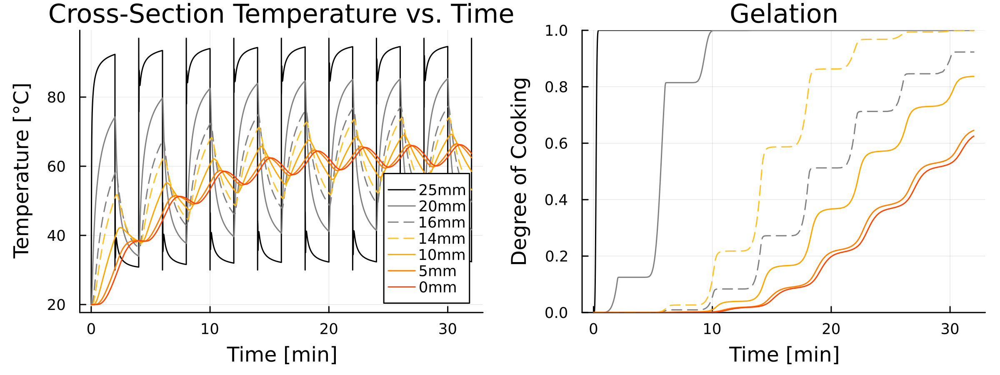

In [95]:
sol = run_simulation(32*60, 4*60, 0.5; T_hot=97., T_cold=30., Δt=1);

sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)

# ylims!(fig[1], 280, 350)
xticks!(0:10:60)
# 
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


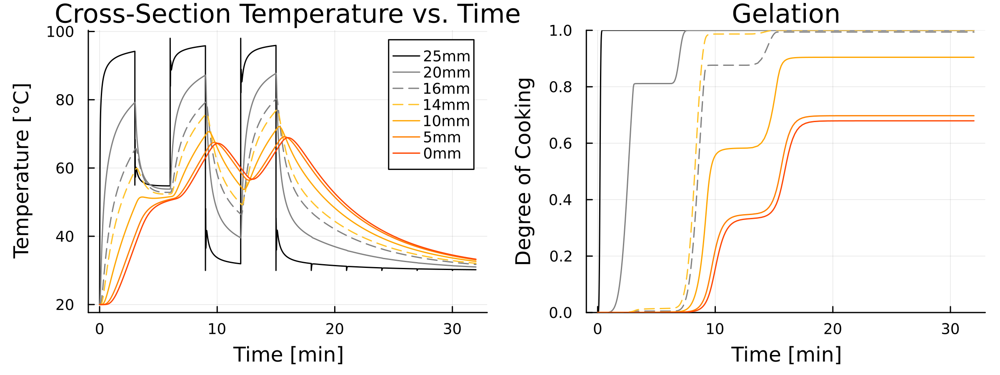

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


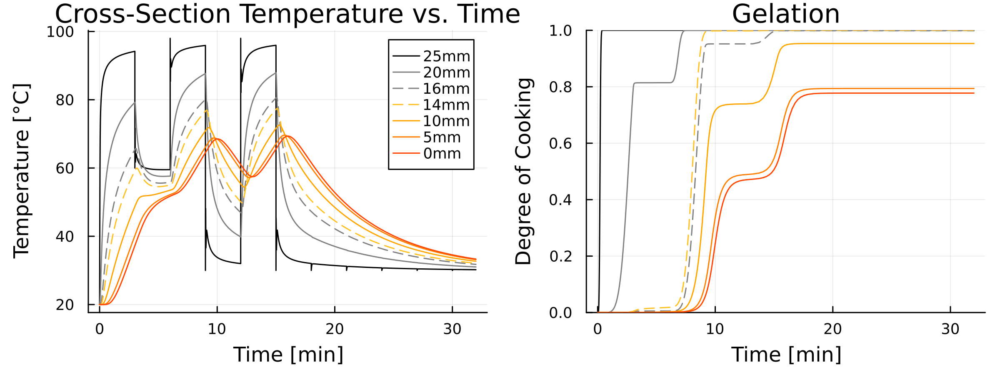

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


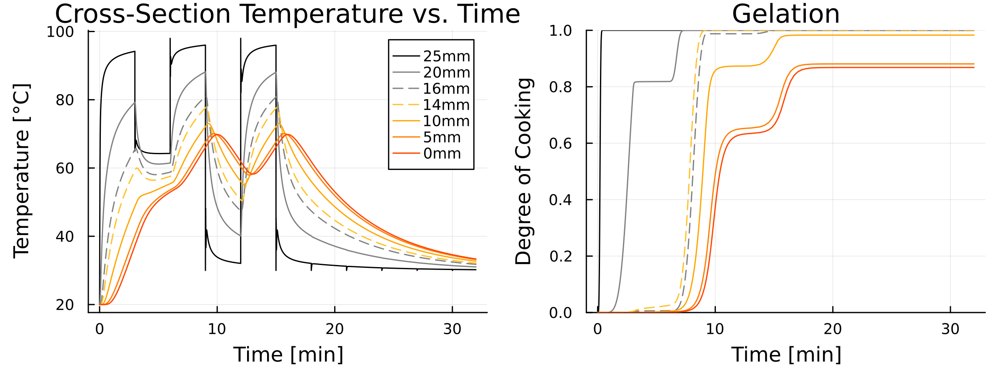

In [ ]:
for t in [55., 60., 65.]
    sol = run_simulation_steps(32*60, 3*60, vcat([98., t, 98., 30., 98., 30.], repeat([30.], 10)); Δt=1) #run_simulation_steps(32*60, 4*60, 0.5; T_hot=97., T_cold=30., Δt=1);

    sol2 = gelation_sim(sol);

    fig = generate_plots(sol, sol2)

    # ylims!(fig[1], 280, 350)
    xticks!(0:10:60)
    # 
    fig |> display
end

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


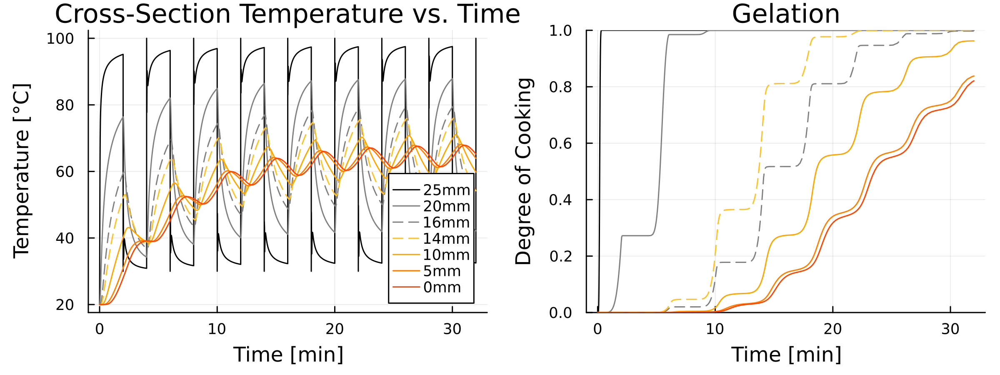

In [98]:
sol = run_simulation(32*60, 4*60, 0.5; T_hot=100., T_cold=30., Δt=1);

sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)

# ylims!(fig[1], 280, 350)
xticks!(0:10:60)
# 
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


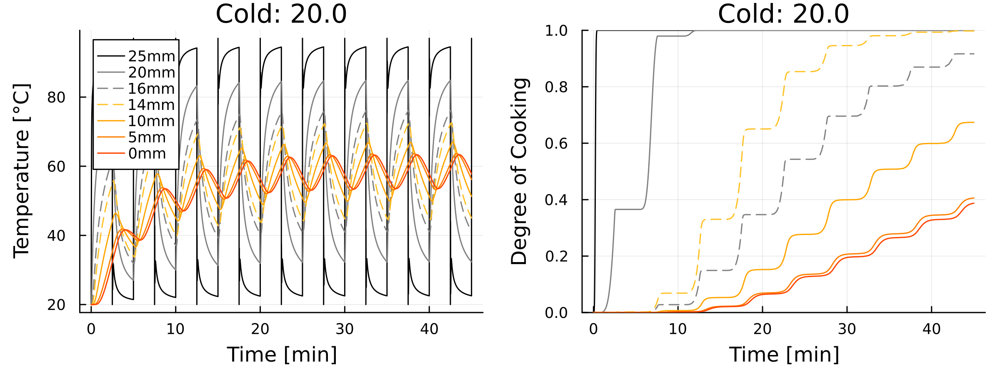

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


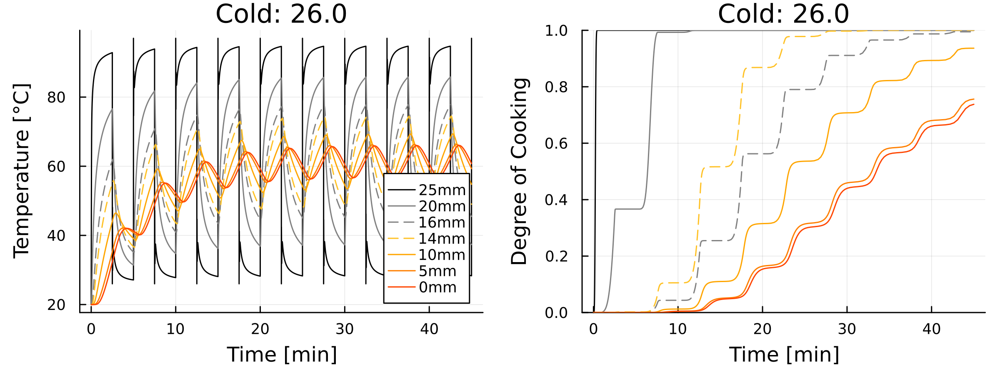

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


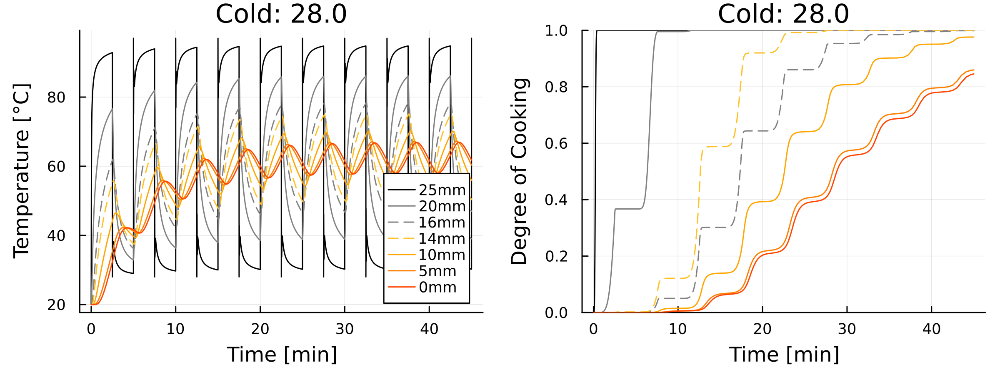

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


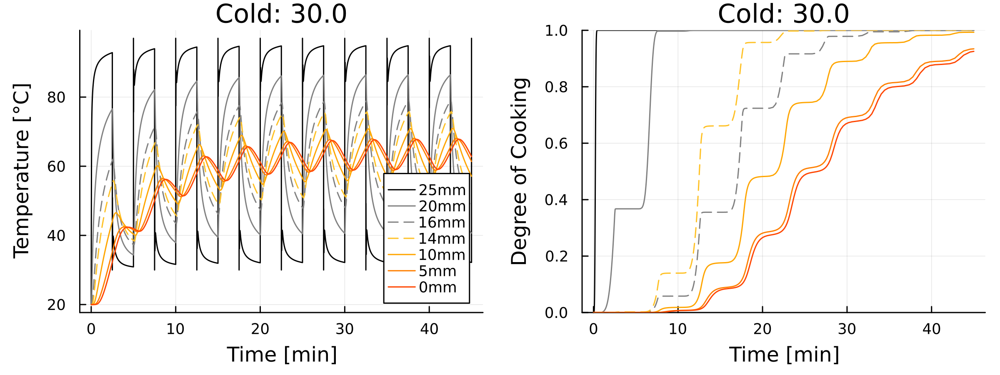

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


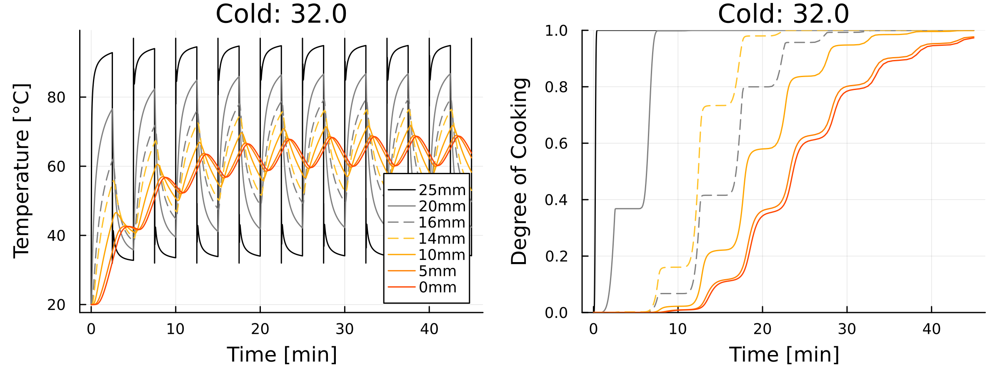

In [99]:
for cold in [20., 26., 28., 30., 32.]
    sol = run_simulation(45*60, 5*60, 0.5; T_hot=97., T_cold=cold, Δt=1);

    sol2 = gelation_sim(sol);

    fig = generate_plots(sol, sol2)

    # ylims!(fig[1], 280, 350)
    xticks!(0:10:60)
    # 
    title!(fig, "Cold: $cold")
    display(fig)
end

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


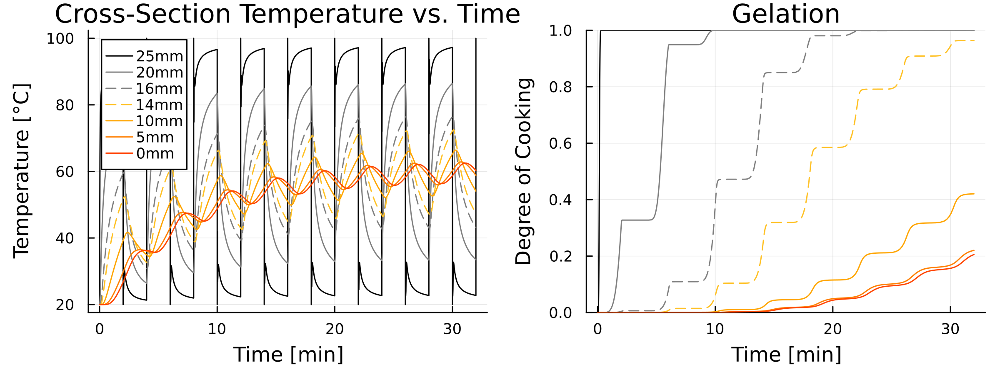

In [30]:
sol = run_simulation(32*60, 4*60, 0.5; T_hot=100., T_cold=20., Δt=1, scaler=0.4, scaler_asym=1.2);

sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)

# ylims!(fig[1], 280, 350)
xticks!(0:10:60)
# 
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


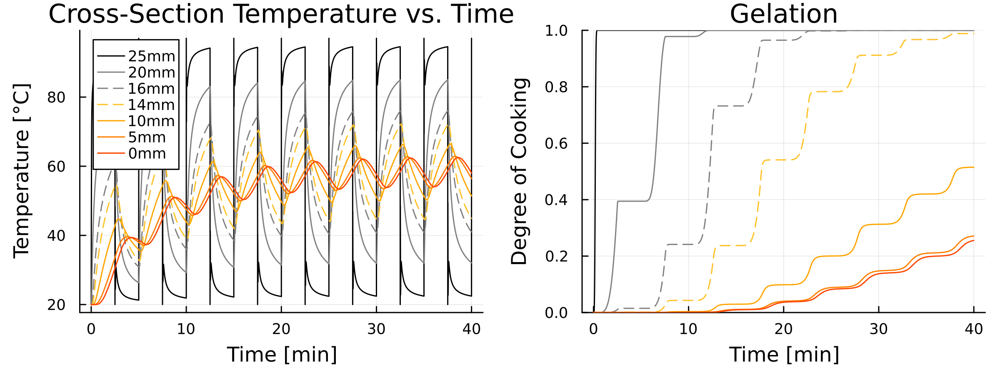

In [36]:
sol = run_simulation(40*60, 5*60, 0.5; T_hot=97., T_cold=20., Δt=1, scaler=0.4, scaler_asym=1.2);

sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)

# ylims!(fig[1], 280, 350)
xticks!(0:10:60)
# 
fig

# Trash

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


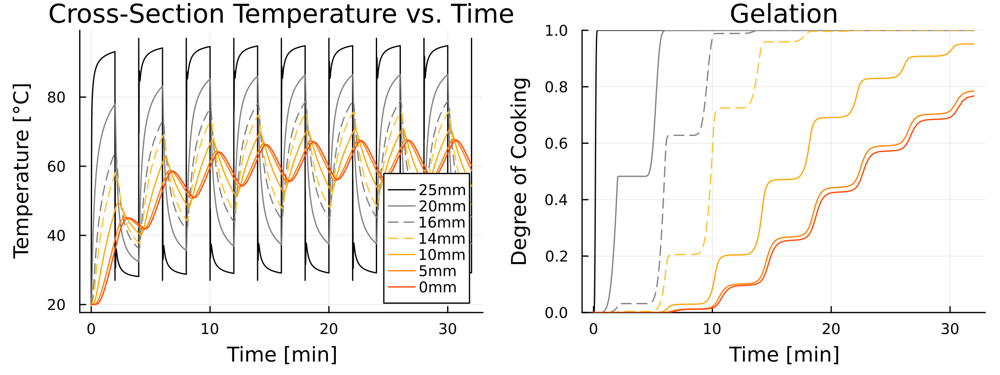

In [363]:
sol = run_simulation(32*60, 4*60, 0.5; T_hot=97., T_cold=27., Δt=1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)

# ylims!(fig[1], 280, 350)
xticks!(0:10:60)

savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/pulsing_egg.png")
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


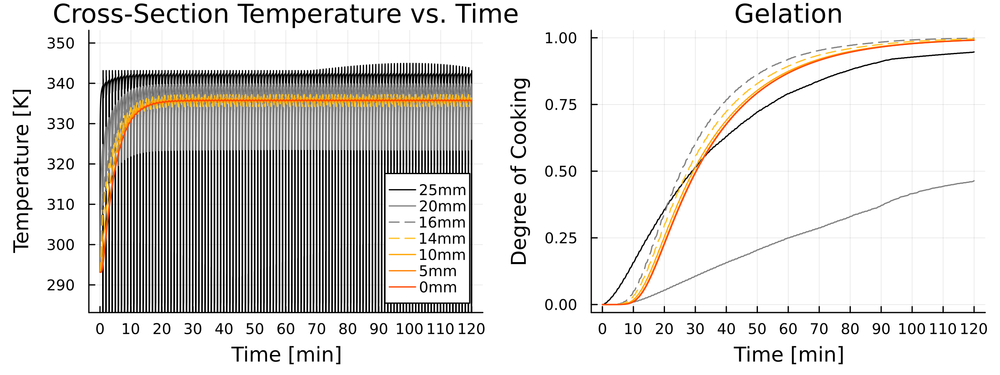

In [ ]:
sol = run_simulation(2*60*60, 1*60, 0.9; T_hot=70., T_cold=0., Δt=1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)
# plot!(fig[2], sous_vide_sims[:, 1], sous_vide_sims[:, [2,3,4,5,7,8,9]], color="green")


ylims!(fig[1], (10+273.15, 80+273.15))
xticks!(0:10:120)
# savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/cursed_egg.png")
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


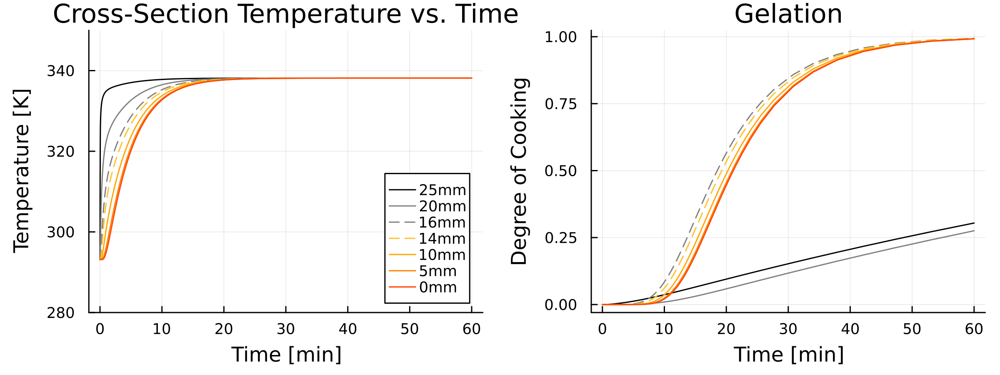

In [ ]:
sol = run_simulation_sin(60*60, 150*60, 0.; T_hot=65., Δt=1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)
# plot!(fig[2], sous_vide_sims[:, 1], sous_vide_sims[:, [2,3,4,5,7,8,9]], color="green")


ylims!(fig[1], 280, 350)
yticks!(fig[1], 280:20:350)
xticks!(0:10:60)

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


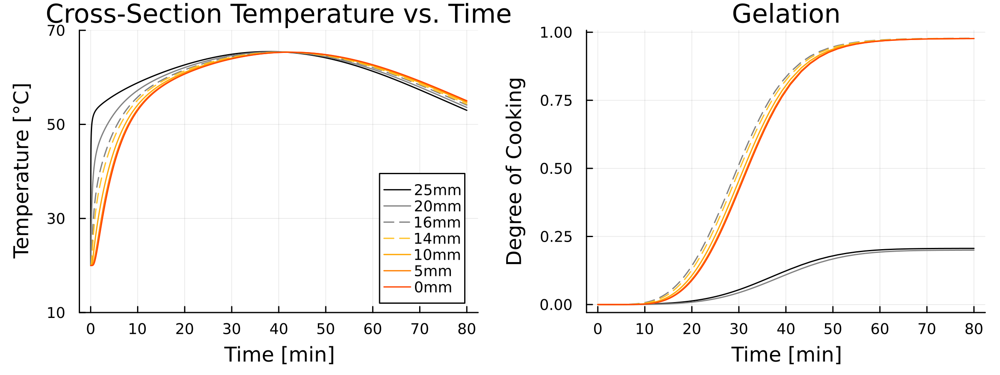

In [72]:
sol = run_simulation_sin(80*60, 150*60, 10.5; T_hot=55., Δt=1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)
# plot!(fig[2], sous_vide_sims[:, 1], sous_vide_sims[:, [2,3,4,5,7,8,9]], color="green")


# ylims!(fig[1], 280, 350)
# yticks!(fig[1], 280:20:350)

ylims!(fig[1], 10, 70)
yticks!(fig[1], 10:20:70)

xticks!(0:10:80)

# savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/cursed_sin_egg.png")
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


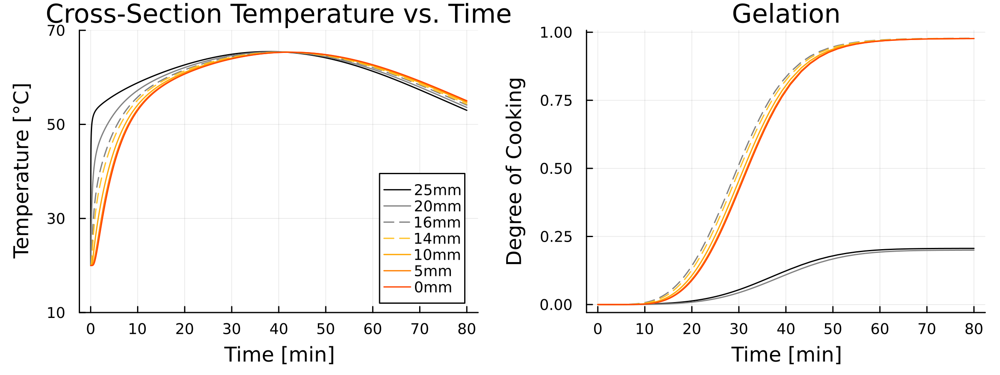

In [84]:
sol = run_simulation_sin(80*60, 150*60, 10.5; T_hot=55., Δt=1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)

ylims!(fig[1], 10, 70)
yticks!(fig[1], 10:20:70)

xticks!(0:10:80)

fig

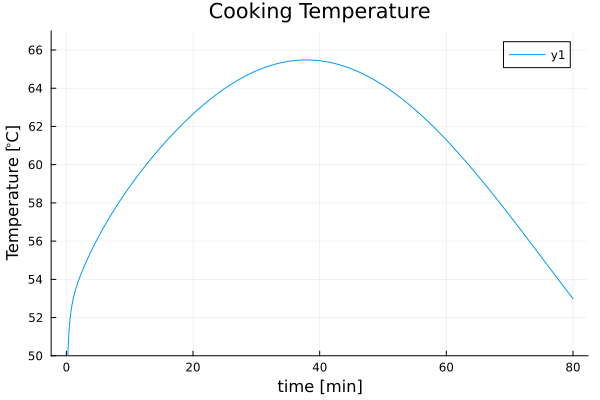

In [85]:
plot(sol.t/60, hcat(sol.u...)[2, :], title="Cooking Temperature")
xlabel!("time [min]")
ylabel!("Temperature [\$\\degree\$C]")
ylims!(50, 67)
yticks!(50:2:67)

In [86]:
maximum(hcat(sol.u...)[2, :])

65.47716459152922

In [87]:
# convert deg Celsius to deg Fahrenheit
cel_to_fahr(c) = c * 9/5 + 32

cel_to_fahr (generic function with 1 method)

In [ ]:
my_profile = hcat(sol(60 .* (0:5:80))...)[2, :][2:end]

16-element Vector{Float64}:
 56.176208661167976
 58.848994797362835
 60.94358673671424
 62.64971648597007
 63.98209931153343
 64.90987427670348
 65.40078633660579
 65.43591726379475
 65.0145580617922
 64.1554455029674
 62.89629031666692
 61.29222052378564
 59.4133909579029
 57.34191933089362
 55.168299824
 52.98745563494984

In [88]:
cel_to_fahr.(hcat(sol(60 .* (0:5:80))...)[2, :])

17-element Vector{Float64}:
  68.0
 133.11717559010236
 137.9281906352531
 141.69845612608563
 144.76948967474613
 147.16777876076017
 148.83777369806626
 149.7214154058904
 149.78465107483055
 149.02620451122596
 147.4798019053413
 145.21332257000046
 142.32599694281413
 138.94410372422522
 135.2154547956085
 131.3029396832
 127.3774201429097

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


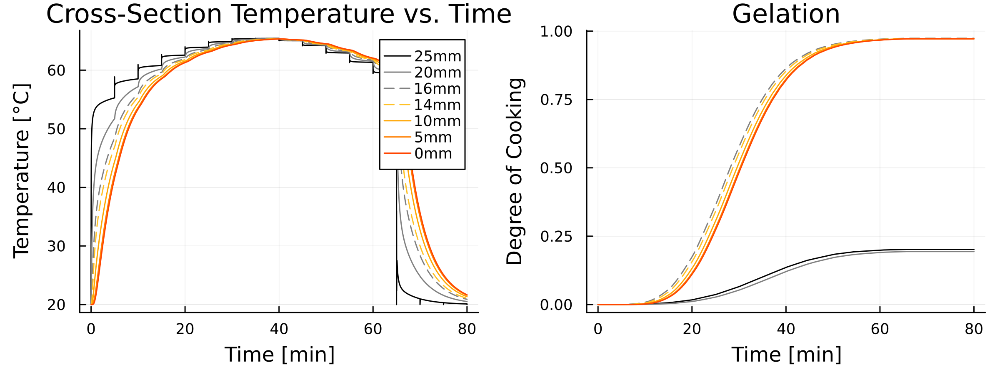

In [122]:
test = run_simulation_steps(80*60, 5*60, vcat(my_profile[1:end-3], repeat([20], 5))
                            ; Δt=1)
# test = run_simulation_steps(32*60, 2*60, repeat([100., 20.], 16); Δt=1)

test2 = gelation_sim(test);

fig = generate_plots(test, test2)
# plot!(fig[2], sous_vide_sims[:, 1], sous_vide_sims[:, [2,3,4,5,7,8,9]], color="green")


# ylims!(fig[1], 280,  390)
# yticks!(fig[1], 280:20:390)
# ylims!(fig[1], 10, 100)
# yticks!(fig[1], 10:20:100)
# xticks!(vcat(0:4:12, [20, 30]))

# savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/faster_pulsing_egg.png")


# ylims!(fig[1], 280, 350)
# xticks!(0:10:60)
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


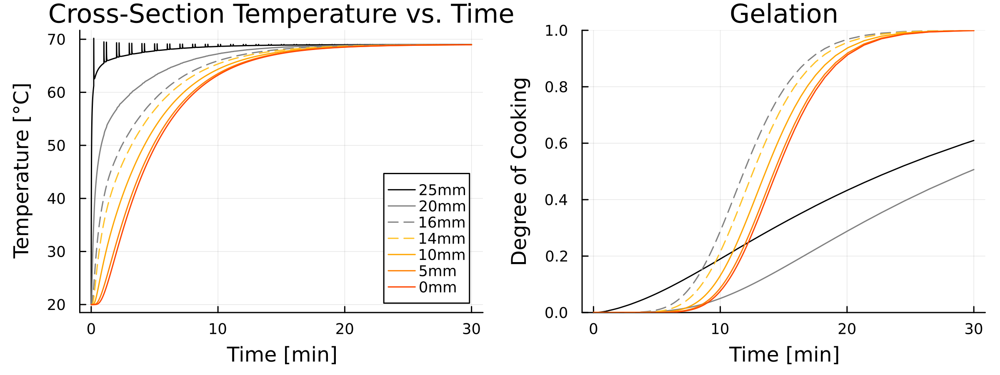

In [290]:
sol = run_simulation(30*60, 60, 0.2; T_hot=69., T_cold=69., Δt=0.1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


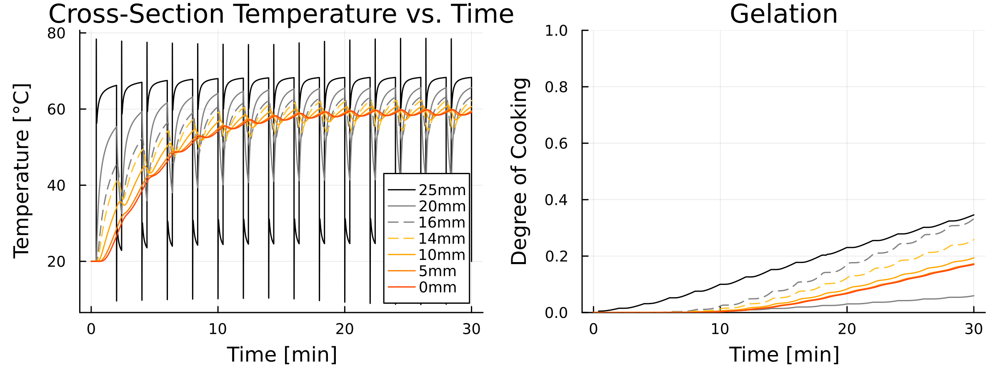

In [293]:
sol = run_simulation(30*60, 60, 0.4; T_hot=20., T_cold=69., Δt=0.1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


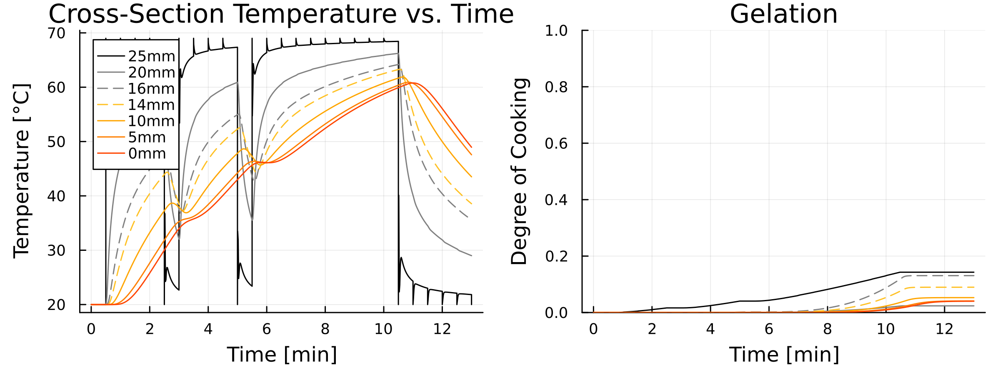

In [280]:
let
    time_step = 0.5
    Th, Tc = 69, 20
    cursed_begin_profile = repeat([Tc, Th, Th, Th, Th], 3)
    cursed_new_profile = [Th, Th, Th, Th, Th, Th] #repeat([Th, Th, Th, Th, Th, Th], 5)

    test = run_simulation_steps((length(cursed_begin_profile) + length(cursed_new_profile) + 5)*time_step*60, time_step*60, vcat(cursed_begin_profile, cursed_new_profile, repeat([20], 5))
                                ; Δt=1)
    # test = run_simulation_steps(32*60, 2*60, repeat([100., 20.], 16); Δt=1)

    test2 = gelation_sim(test);

    fig = generate_plots(test, test2)
    # plot!(fig[2], sous_vide_sims[:, 1], sous_vide_sims[:, [2,3,4,5,7,8,9]], color="green")


    # ylims!(fig[1], 280,  390)
    # yticks!(fig[1], 280:20:390)
    # ylims!(fig[1], 10, 100)
    # yticks!(fig[1], 10:20:100)
    # xticks!(vcat(0:4:12, [20, 30]))

    # savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/faster_pulsing_egg.png")


    # ylims!(fig[1], 280, 350)
    # xticks!(0:10:60)
    display(fig)
end;

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


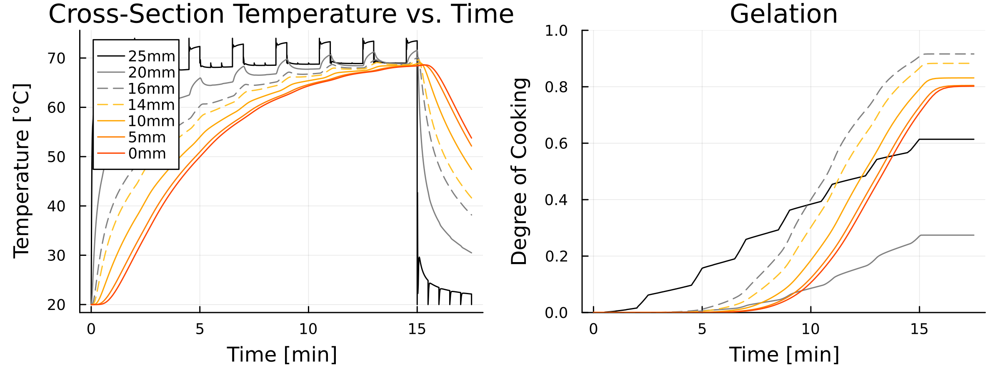

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


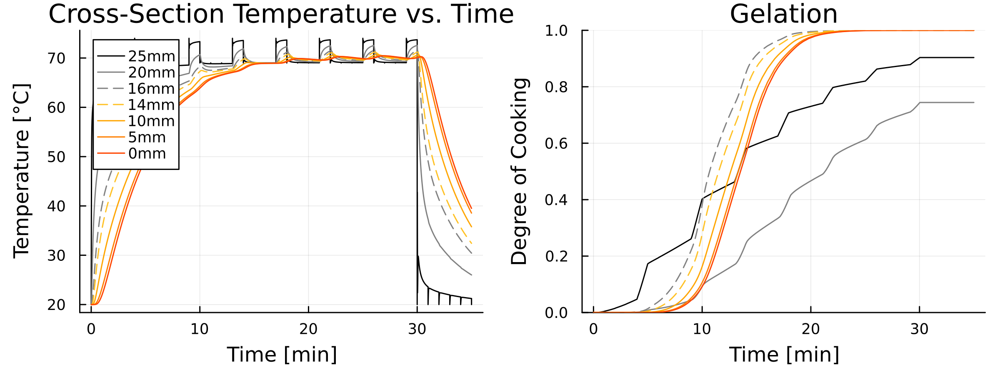

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


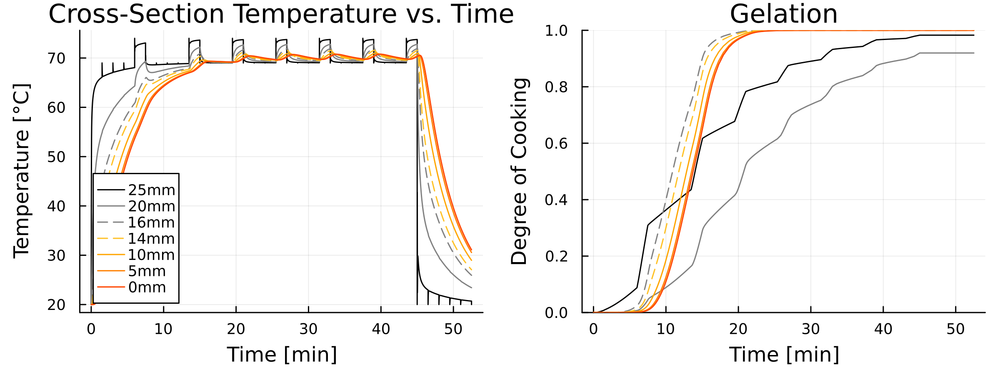

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


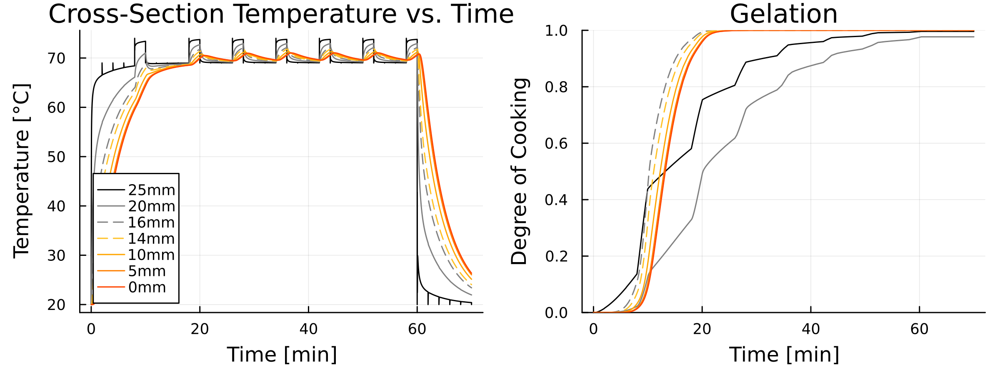

In [281]:
for time_step in [0.5, 1, 1.5, 2]
    Th, Tc = 74, 69
    cursed_begin_profile = repeat([Tc, Tc, Tc, Tc, Th], 2)
    cursed_new_profile = repeat([Tc, Tc, Tc, Th], 5)

    test = run_simulation_steps((length(cursed_begin_profile) + length(cursed_new_profile) + 5)*time_step*60, time_step*60, vcat(cursed_begin_profile, cursed_new_profile, repeat([20], 5))
                                ; Δt=1)
    # test = run_simulation_steps(32*60, 2*60, repeat([100., 20.], 16); Δt=1)

    test2 = gelation_sim(test);

    fig = generate_plots(test, test2)
    # plot!(fig[2], sous_vide_sims[:, 1], sous_vide_sims[:, [2,3,4,5,7,8,9]], color="green")


    # ylims!(fig[1], 280,  390)
    # yticks!(fig[1], 280:20:390)
    # ylims!(fig[1], 10, 100)
    # yticks!(fig[1], 10:20:100)
    # xticks!(vcat(0:4:12, [20, 30]))

    # savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/faster_pulsing_egg.png")


    # ylims!(fig[1], 280, 350)
    # xticks!(0:10:60)
    display(fig)
end;

In [362]:
n=5
time_step = 2

min_loss = 100_000
min_sol = nothing

Th, Tc = 69, 74

for i = 1:2^(n+1)-1
    s = bitstring(i)
    pulse = [(i=='0' ? Tc : Th) for i in s[length(s)-n:end]]
    pulse |> print
    " -> " |> print

    pulse = repeat(pulse, 10)

    test = run_simulation_steps((length(pulse) + 5)*time_step*60, time_step*60, vcat([20], pulse, repeat([20], 5)) ; Δt=1)
    test2 = gelation_sim(test);

    # loss = (sum(test2.u[end][1:9])^2 + (16 - sum(test2.u[end][10:25]))^2)
    loss = minimum([sum(i[1:9])^2 + (16 - sum(i[10:25]))^2 for i in test2.u])

    if loss < min_loss
        min_loss = loss
        min_sol = pulse
    end

    loss |> println;
end

min_loss

# timestep 0.5
    # 16 for 74, 69
    # 38 for 74, 20
    # 13.4 for 69, 20

[74, 74, 74, 74, 74, 69] -> 31.491990103287556
[74, 74, 74, 74, 69, 74] -> 34.535055314063804
[74, 74, 74, 74, 69, 69] -> 30.556360180788413
[74, 74, 74, 69, 74, 74] -> 35.73036456853944
[74, 74, 74, 69, 74, 69] -> 30.65109581491454
[74, 74, 74, 69, 69, 74] -> 33.18529137197012
[74, 74, 74, 69, 69, 69] -> 29.907884359301057
[74, 74, 69, 74, 74, 74] -> 36.5855829512533
[74, 74, 69, 74, 74, 69] -> 31.103215007530753
[74, 74, 69, 74, 69, 74] -> 33.45828467728094
[74, 74, 69, 74, 69, 69] -> 29.95936669865667
[74, 74, 69, 69, 74, 74] -> 34.736847300539615
[74, 74, 69, 69, 74, 69] -> 30.384274019605897
[74, 74, 69, 69, 69, 74] -> 32.364186899179295
[74, 74, 69, 69, 69, 69] -> 29.27845072152497
[74, 69, 74, 74, 74, 74] -> 37.279252959119574
[74, 69, 74, 74, 74, 69] -> 31.434679914914362
[74, 69, 74, 74, 69, 74] -> 34.04802489639271
[74, 69, 74, 74, 69, 69] -> 26.955637206916606
[74, 69, 74, 69, 74, 74] -> 35.15630845737264
[74, 69, 74, 69, 74, 69] -> 28.08465768602292
[74, 69, 74, 69, 69, 74]

13.297144214647606

In [ ]:
Threads.@threads for i in 1:10

end

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


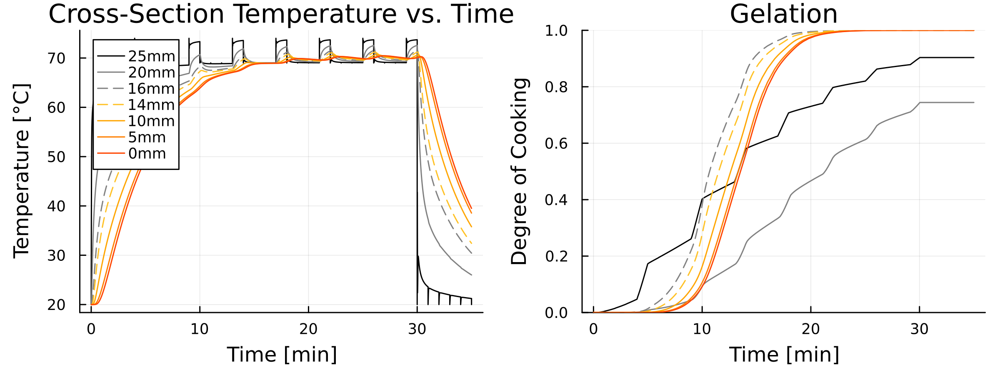

(7.185462963093945, 10.999792465698997)

In [337]:
# for 
Th, Tc = 74, 69
cursed_begin_profile = repeat([Tc, Tc, Tc, Tc, Th], 2)
cursed_new_profile = repeat([Tc, Tc, Tc, Th], 5)

test = run_simulation_steps((length(cursed_begin_profile) + length(cursed_new_profile) + 5)*time_step*60, time_step*60, vcat(cursed_begin_profile, cursed_new_profile, repeat([20], 5))
                            ; Δt=1)
# test = run_simulation_steps(32*60, 2*60, repeat([100., 20.], 16); Δt=1)

test2 = gelation_sim(test);

fig = generate_plots(test, test2)

display(fig)

sum(test2.u[end][1:9]), sum(test2.u[end][15:25])

In [304]:
sol.prob.p

(n = 50, n_yolk = 30, thermal_state = 0.0)

In [57]:
using Interpolations

# interp_linear = linear_interpolation(sol.t/60, hcat(sol.u...)[2, :])
linear_interpolation

LoadError: UndefVarError: `linear_interpolation` not defined in `Main`
Suggestion: check for spelling errors or missing imports.

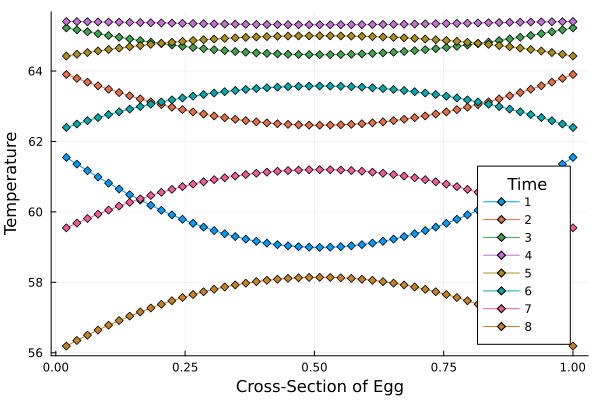

In [1314]:
p1 = Plots.plot(ylabel="Temperature", xlabel="Cross-Section of Egg", legend_title="Time")
for (idx, tvec) in enumerate(sol.u[1000:Integer(floor(end//10)):end])
    Plots.plot!(zf[2:end], tvec[2:end-1], label = idx, markershape = :diamond)
end
p1

# plot(zf[1:end-1], sol.u[2][2:end-1], markershape = :diamond)

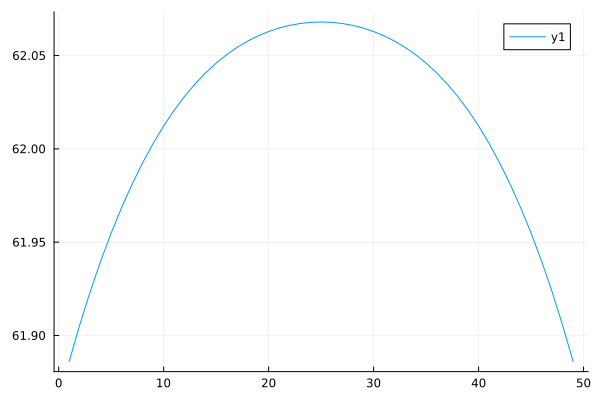

In [1293]:
zf = range(0, 1, length=sol.prob.p[:n])

# Plots.plot!(zf[2:end-1], tvec[2:end-1], label = idx, markershape = :diamond)
# plot(zf[2:end-1], median(hcat(sol.u...)[2:end-1, :]; dims=2), label="simulation", ylabel="Median Temperature", title="Median Temperature While Cooking Egg", xlabel="Position in Egg")

plot( mean(hcat(sol.u...)[2:end-1, 800:end]; dims=2) )

# vline!(zf[[1 + div(sol.prob.p[:n] - 1, 2) - div(sol.prob.p[:n_yolk], 2), 1 + div(sol.prob.p[:n] - 1, 2) + div(sol.prob.p[:n_yolk], 2)]], label="Egg Yolk")

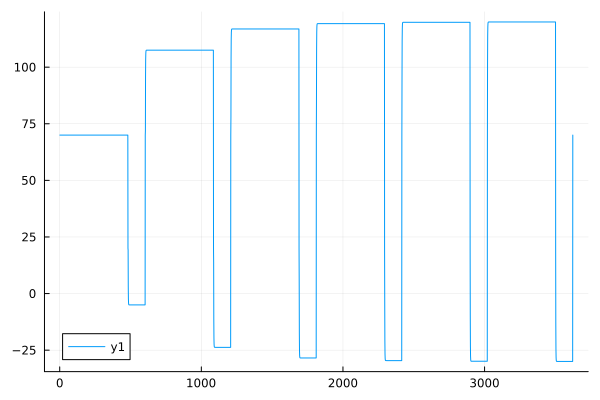

In [1178]:
plot(hcat(sol.u...)[1, :])

positions = [1, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(n / 2)) + 0] = [1, 6, 10, 12, 16, 21, 26]


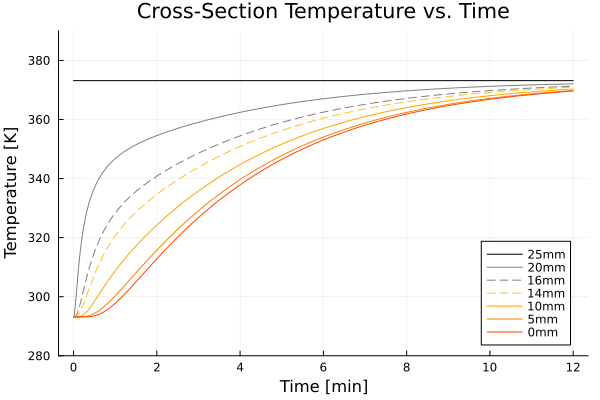

In [ ]:
p1 = Plots.plot(; xlabel="Time [min]", 
ylabel = plot_in_kelvin ? "Temperature [K]" : "Temperature [°C]", 
title="Cross-Section Temperature vs. Time")

@show positions = [
    1,
    1 + Integer(round(sol.prob.p.n / 2 * 0.2)),
    1 + Integer(round(sol.prob.p.n / 2 * 0.36)),
    1 + Integer(round(sol.prob.p.n / 2 * 0.44)),

    1 + Integer(round(sol.prob.p.n / 2 * 0.6)),
    1 + Integer(round(sol.prob.p.n / 2 * 0.8)),
    1 + Integer(floor(n/2)) + 0
]

labels = [
    "25mm",
    "20mm",
    "16mm",
    "14mm",
    "10mm",
    "5mm",
    "0mm"
]

colors = [
    :black,
    :grey,
    :grey,
    :goldenrod1,
    :orange,
    :darkorange1,
    :orangered
]

styles = [
    :solid,
    :solid,
    :dash,
    :dash,
    :solid,
    :solid,
    :solid
]

for (i, pos) in enumerate(positions)
    Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[pos, :], label=labels[i], color=colors[i], style=styles[i])
end

# 
# Plots.plot!(sol.t/60, hcat(sol.u...)[2, :], label="0mm", color=:grey)
# Plots.plot!(sol.t, hcat(sol.u...)[3, :], label="albumen", color=:grey)
# Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[Integer(round(sol.prob.p.n / 2 * 0.2)), :], label="20mm", color=:grey)
# Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[Integer(round(sol.prob.p.n / 2 * 0.36)), :], label="16mm", color=:grey)
# # Plots.plot!(hcat(sol.u...)[5, :], label="albumen", color=:grey)
# # Plots.plot!(hcat(sol.u...)[Integer(floor(n/2)) - 2, :], label="yolk", color=:orange)
# Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[Integer(round(sol.prob.p.n / 2 * 0.44)), :], label="14mm", color=:orange)

# Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[Integer(round(sol.prob.p.n / 2 * 0.6)), :], label="10mm", color=:orange)

# Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[Integer(round(sol.prob.p.n / 2 * 0.8)), :], label="5mm", color=:orange)
# Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[Integer(floor(n/2)) + 0, :], label="yolk", color=:orange)
# Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[Integer(round(sol.prob.p.n / 2 * 0.8)), label="yolk", color=:orange)
# Plots.plot!(hcat(sol.u...)[Integer(floor(n/2)) + 2, :], label="yolk", color=:orange)
# Plots.plot!(hcat(sol.u...)[n-3, :], label="albumen", color=:black)
# Plots.plot!(sol.t, hcat(sol.u...)[n-2, :], label="albumen", color=:black)
# Plots.plot!(sol.t, hcat(sol.u...)[n-1, :], label="albumen", color=:black)
# Plots.plot!(hcat(sol.u...)[n, :], label="albumen", color=:black)

ylims!(280,  390)
yticks!(280:20:390)
xticks!(0:2:12)
# vline!([4], label=nothing)
# hline!([318], label=nothing)

# ylims!(260-270,  400-270)

In [521]:
Ai_albumen, Eai_albumen = 2.72e50, 3.443e5 # s^-1 and J
Ai_yolk, Eai_yolk       = 4.85e60, 4.185e5 # s^-1 and J

R = 8.3144598 # J⋅mol^−1⋅K^−1

n, n_yolk, _ = sol.prob.p

i1, i2 = 1 + div(n - 1, 2) - div(n_yolk, 2), 1 + div(n - 1, 2) + div(n_yolk, 2)

Ai_vec = Ai_albumen * ones(n+1)
Ai_vec[i1:i2] .= Ai_yolk

Eai_vec = Eai_albumen * ones(n+1)
Eai_vec[i1:i2] .= Eai_yolk

function cooking!(du, u, p, t)
    temp = sol(t) .+ 273.15
    du .= Ai_vec .* exp.(-Eai_vec ./ (R .* (temp))) .* (1 .- u)
end

u0 = zeros(length(sol.u[1]))
cooking_prob = ODEProblem(cooking!, u0, (sol.t[1], sol.t[end]))
sol2 = solve(cooking_prob, Rosenbrock23())#Tsit5())

retcode: Success
Interpolation: specialized 2nd order "free" stiffness-aware interpolation
t: 353-element Vector{Float64}:
   0.0
   1.2950101453138805e-6
   1.4245111598452684e-5
   8.845482832497545e-5
   0.000205639101742629
   0.00044916357649719756
   0.0007943126291779767
   0.001347595471145237
   0.00207000428640197
   0.0030718449650450584
   0.004312426478795119
   0.005901357964409797
   0.007816981092917851
   ⋮
 372.5912201135456
 377.73911767982304
 384.4757055884638
 395.78474789666444
 404.06478430135087
 424.2173714322317
 460.33466315602095
 574.2791084589257
 611.2468046652756
 653.8297216959876
 696.4126387266996
 720.0
u: 353-element Vector{Vector{Float64}}:
 [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
 [0.00022469129657410984, 1.582236833858004e-17, 1.5822280554980022e-17, 1.58222448756697e-17, 1.5822230508902428e-17, 1.5822224747289547e-17, 1.5822222440401905e-17, 1.5822221517313808e-17, 1.58222211479526

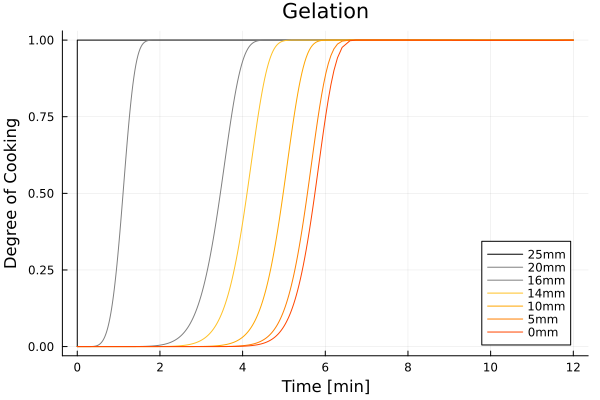

In [527]:
p2 = plot(title="Gelation", xlabel="Time [min]", ylabel="Degree of Cooking")

for (i, pos) in enumerate(positions)
    plot!(sol2.t/60, hcat(sol2.u...)[pos, :], label=labels[i], color=colors[i])
end
# plot!(sol2.t/60, hcat(sol2.u...)[3, :])
# # plot!(sol2.t/60, hcat(sol2.u...)[6, :])
# plot!(sol2.t/60, hcat(sol2.u...)[10, :])
# plot!(sol2.t/60, hcat(sol2.u...)[20, :])
# plot!(sol2.t/60, hcat(sol2.u...)[25, :])

xticks!(0:2:12)
plot!()

In [528]:
plot(p1, p2, layout=(1, 2), size=(800, 300), dpi=300, left_margin = 5Plots.mm, bottom_margin=5Plots.mm)
savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/hard_boiled_egg.png")

"/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/hard_boiled_egg.png"

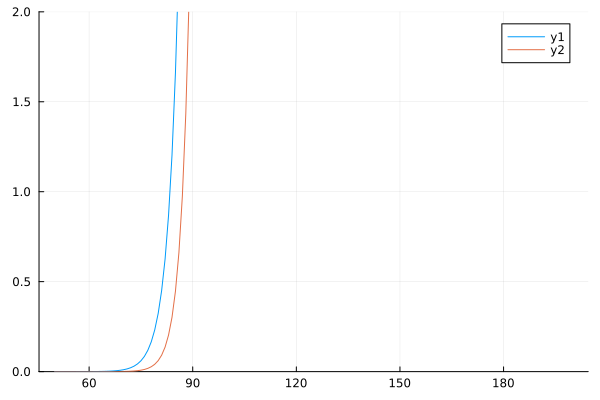

In [345]:
temp_sweep = 50.:1.:200.

plot()

plot!(temp_sweep, (Ai_albumen .* (exp.(-Eai_albumen ./ (R .* (temp_sweep .+ 273.15))))))
plot!(temp_sweep, (Ai_yolk .* exp.(-Eai_yolk ./ (R .* (temp_sweep .+ 273.15)))))

# plot!(yscale=:log)
# plot!(temp_sweep, (-Eai_albumen ./ (R .* (temp_sweep))))
# plot!(temp_sweep, (-Eai_yolk ./ (R .* (temp_sweep))))

# hline!([0])
ylims!(0, 2)

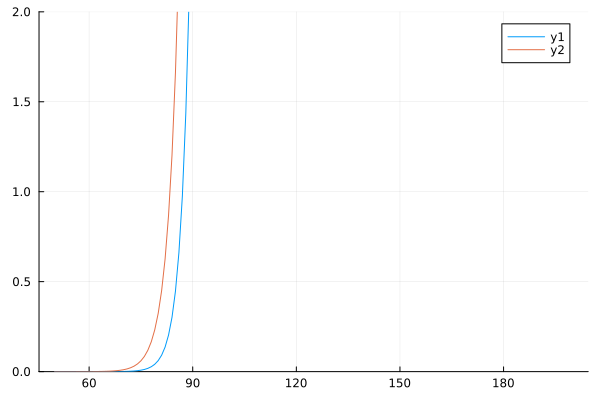

In [137]:
temp_sweep = 50.:1.:200.

plot()

plot!(temp_sweep, (Ai_albumen .* (exp.(-Eai_albumen ./ (R .* (temp_sweep .+ 273.15))))))
plot!(temp_sweep, (Ai_yolk .* exp.(-Eai_yolk ./ (R .* (temp_sweep .+ 273.15)))))

# plot!(yscale=:log)
# plot!(temp_sweep, (-Eai_albumen ./ (R .* (temp_sweep))))
# plot!(temp_sweep, (-Eai_yolk ./ (R .* (temp_sweep))))

# hline!([0])
ylims!(0, 2)

In [1]:
plot_in_kelvin = false
temperature_offset = plot_in_kelvin ? 273.15 : 0

Plots.plot(sol.t/60, temperature_offset .+ hcat(sol.u...)[1, :], title="Drive Temperature")
Plots.plot!(sol.t/60,temperature_offset .+ hcat(sol.u...)[n+1, :])

LoadError: UndefVarError: `sol` not defined in `Main`
Suggestion: check for spelling errors or missing imports.

In [58]:
# Plots.plot!(zf[2:end-1], tvec[2:end-1], label = idx, markershape = :diamond)
plot(zf[2:end-1], median(hcat(sol.u...)[2:end-1, :]; dims=2), ylabel="Aggregate Simulated Temperature", label="Median Temperature", xlabel="Position in Egg")
plot!(zf[2:end-1], mean(hcat(sol.u...)[2:end-1, :]; dims=2), label="Mean Temperature")

vline!(zf[[1 + div(n - 1, 2) - div(n_yolk, 2), 1 + div(n - 1, 2) + div(n_yolk, 2)]], label="Egg Yolk")

LoadError: UndefVarError: `zf` not defined in `Main`
Suggestion: check for spelling errors or missing imports.

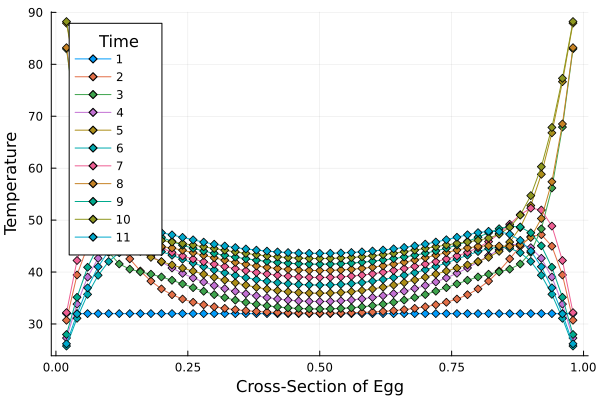

In [1222]:
p1 = Plots.plot(ylabel="Temperature", xlabel="Cross-Section of Egg", legend_title="Time")
for (idx, tvec) in enumerate(sol.u[1:Integer(floor(end//10)):end])
    Plots.plot!(zf[2:end-1], tvec[2:end-1], label = idx, markershape = :diamond)
end
p1

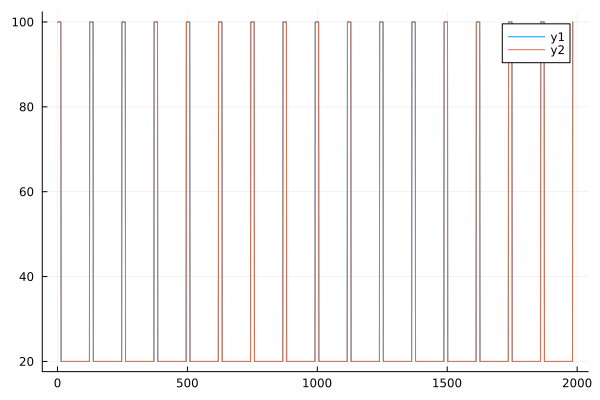

In [431]:
Plots.plot(hcat(sol.u...)[1, :])
Plots.plot!(hcat(sol.u...)[n+1, :])

# Plots.plot!(hcat(sol.u...)[2, :], label="albumen", color=:grey)

In [ ]:
Ai_yolk = 2.72
Ai_albumen = 

In [ ]:
# Define your parameters
R_i(t) =  # Define your A_i(t) function here
dt = 0.01  # Time step
t_end = 10.0  # End time
t = 0:dt:t_end  # Time array
X_i = zeros(length(t))  # Initialize X_i array
X_i[1] = 1.0  # Initial condition for X_i

# Trapezoidal integration
for n in 1:length(t)-1
    t_n = t[n]
    t_n1 = t[n+1]
    A_n = R_i(t_n)
    A_n1 = R_i(t_n1)
    X_n = X_i[n]
    f_n = A_n * (1 - X_n)
    X_tilde = X_n + dt * f_n  # Euler prediction
    f_tilde = A_n1 * (1 - X_tilde)
    X_i[n+1] = X_n + (dt / 2) * (f_n + f_tilde)  # Trapezoidal correction
end

# Now X_i contains the solution at each time step


LoadError: ParseError:
[90m# Error @ [0;0m]8;;file:///Users/torque/programs/egg_sims/In[539]#2:10\[90mIn[539]:2:10[0;0m]8;;\
# Define your parameters
A_i(t) = [48;2;120;70;70m...[0;0m # Define your A_i(t) function here
[90m#        └─┘ ── [0;0m[91minvalid identifier[0;0m

In [547]:
using LinearAlgebra
using DiffEqBase
using OrdinaryDiffEq: SplitODEProblem, solve, IMEXEuler
# using OrdinaryDiffEqBDF: IMEXEuler
import SciMLBase

In [548]:
using Plots

In [755]:
ρ_yolk = 1030.0   # kg/m^3
ρ_albumen = 1020.0  # kg/m^3
c_p_yolk = 3.7  # kJ/(kg·°C)
c_p_albumen = 3.8  # kJ/(kg·°C)
k_yolk = 0.5  # W/(m·°C)
k_albumen = 0.6  # W/(m·°C)

α_yolk = k_yolk / (ρ_yolk * c_p_yolk) # m^2/s
α_albumen = k_albumen / (ρ_albumen * c_p_albumen) # m^2/s

# renormalize for egg lengthscales
# 62mm	43mm
egg_diameter = 10 * 62e-3 # 43mm
α_yolk /= egg_diameter^2 # mm/s
α_albumen /= egg_diameter^2 # mm/s

α_yolk, α_albumen

(0.00034130894985789256, 0.0004027022934701017)

In [828]:
a, b, n = 0, 1, 50               # zmin, zmax, number of cells
n_yolk = 11
n̂_min, n̂_max = -1, 1            # Outward facing unit vectors
# α = α_albumen;                        # thermal diffusivity, larger means more stiff
β, γ = 0, π;                # source term coefficients
Δt = 1; #1000;                      # timestep size
@show N_t = Integer(ceil(32*60 / Δt));                       # number of timesteps to take
FT = Float64;                   # float type
Δz = FT(b - a) / FT(n)
Δz² = Δz^2;
∇²_op = [1 / Δz², -2 / Δz², 1 / Δz²]; # interior Laplacian operator
# ∇T_bottom = 100; #100;                 # Temperature gradient at the top
# T_bottom = 60;
# T_top = 60;                      # Temperature at the bottom

T_hot = 100;
T_cold = 20;
S(z) = β * sin(γ * z)               # source term, (sin for easy integration)
zf = range(a, b, length = n + 1);   # coordinates on cell faces

pulsing_period = 2*60;
# pulsing_asym = 3;

N_t = Integer(ceil((32 * 60) / Δt)) = 1920


┌ Warning: Skipped marker arg o.
└ @ Plots ~/.julia/packages/Plots/Ec1L1/src/args.jl:1149


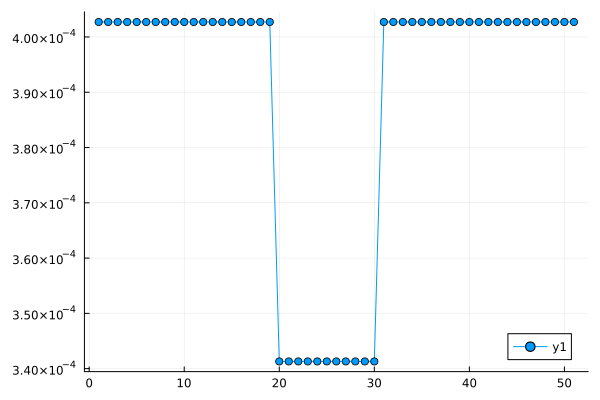

In [829]:
# # Make a vector α_vec of length n  that begins and ends with α_albumen and the middle n_yolk items are α_yolk
# α_vec = [α_albumen for i in 1:n]
# α_vec[1 + div(n - 1, 2) - div(n_yolk, 2):1 + div(n - 1, 2) + div(n_yolk, 2)] .= α_yolk

α_vec = [α_albumen for i in 1:n+1]
α_vec[1 + div(n - 1, 2) - div(n_yolk, 2):1 + div(n - 1, 2) + div(n_yolk, 2)] .= α_yolk
plot(α_vec, marker="o")

In [830]:
function T_analytic(z) # Analytic steady state solution
    c1 = T_bottom #∇T_bottom - β * cos(γ * a) / (γ * α)
    c2 = T_top - (β * sin(γ * b) / (γ^2 * α) + c1 * b)
    return β * sin(γ * z) / (γ^2 * α) + c1 * z + c2
end

T_analytic (generic function with 1 method)

In [831]:
# Initialize interior and boundary stencils:
∇² = Tridiagonal(ones(FT, n) .* ∇²_op[1],
    ones(FT, n + 1) .* ∇²_op[2],
    ones(FT, n) .* ∇²_op[3]);

# Modify boundary stencil to account for BCs

# ∇².d[1] = -2 / Δz²
# ∇².du[1] = +2 / Δz²

∇².du[1] = 0  # modified stencil
∇².d[1] = 0 # to ensure `∂_t T = 0` at `z=0`
∇².dl[1] = 0  # to ensure `∂_t T = 0` at `z=0`

# Modify boundary stencil to account for BCs
∇².du[n] = 0  # modified stencil
∇².d[n + 1] = 0 # to ensure `∂_t T = 0` at `z=zmax`
∇².dl[n] = 0  # to ensure `∂_t T = 0` at `z=zmax`
D = α_vec .* ∇²

51×51 Matrix{Float64}:
 0.0   0.0       0.0       0.0      …   0.0       0.0       0.0      0.0
 0.0  -2.01351   1.00676   0.0          0.0       0.0       0.0      0.0
 0.0   1.00676  -2.01351   1.00676      0.0       0.0       0.0      0.0
 0.0   0.0       1.00676  -2.01351      0.0       0.0       0.0      0.0
 0.0   0.0       0.0       1.00676      0.0       0.0       0.0      0.0
 0.0   0.0       0.0       0.0      …   0.0       0.0       0.0      0.0
 0.0   0.0       0.0       0.0          0.0       0.0       0.0      0.0
 0.0   0.0       0.0       0.0          0.0       0.0       0.0      0.0
 0.0   0.0       0.0       0.0          0.0       0.0       0.0      0.0
 0.0   0.0       0.0       0.0          0.0       0.0       0.0      0.0
 0.0   0.0       0.0       0.0      …   0.0       0.0       0.0      0.0
 0.0   0.0       0.0       0.0          0.0       0.0       0.0      0.0
 0.0   0.0       0.0       0.0          0.0       0.0       0.0      0.0
 ⋮                          

In [832]:
# AT_b = zeros(FT, n + 1);
# AT_b[2] = α_albumen * T_hot / Δz²; #α * 2 / Δz * ∇T_bottom * n̂_min;
# AT_b[end - 1] = α_albumen * T_hot / Δz²;

In [833]:
T = zeros(FT, n + 1);
T .= 32; 
T[1] = T_hot; # set top BC
T[n + 1] = T_hot; # set top BC

In [834]:
function temp_from_thermal_state(thermal_state)
    if thermal_state == 0
        return T_hot
    else
        return T_cold
    end
end

function condition(u, t, integrator)
    mod(t, pulsing_period) == 0
end

function affect!(integrator)
    thermal_state = mod(integrator.p[2] + 1, 3)
    integrator.p = (; n=integrator.p[1], thermal_state=thermal_state)

    T = temp_from_thermal_state(thermal_state)

    integrator.u[1] = T
    integrator.u[2] = T
    integrator.u[end-1] = T
    integrator.u[end] = T
end

cb = DiscreteCallback(condition, affect!)

DiscreteCallback{typeof(condition), typeof(affect!), typeof(SciMLBase.INITIALIZE_DEFAULT), typeof(SciMLBase.FINALIZE_DEFAULT), Nothing}(Main.condition, Main.affect!, SciMLBase.INITIALIZE_DEFAULT, SciMLBase.FINALIZE_DEFAULT, Bool[1, 1], nothing)

In [835]:
function rhs!(dT, T, params, t)
    n = params.n
    i = 1:n # interior domain
    # dT[i] .= S.(zf[i]) .+ AT_b[i]
    AT_b = α_albumen * temp_from_thermal_state(params.thermal_state) / Δz²; #zeros(FT, n + 1);
    # AT_b[2] = α_albumen * temp_from_thermal_state(params.thermal_state) / Δz²
    # AT_b[n-1] = α_albumen * temp_from_thermal_state(params.thermal_state) / Δz²
    # dT[i] .= AT_b[i]
    # dT = D * T
    dT .= 0
    dT[2] += AT_b 
    dT[end-1] += AT_b
    return dT
end;

In [836]:
# function simD!(dT, T, params, t)
#     dT = D * T
# end

function adaD(u, p, t)
    D
end

adaD (generic function with 1 method)

In [837]:
clamp(100, 0, 1)

1

In [841]:
params = (; n, thermal_state=0)

tspan = (FT(0), N_t * FT(Δt))

function update_func!(A, u, p, t)
    # A .= 0.
    # if t > 100
    A .= dynamic_alpha_vec(u) .* ∇²
    # end
    # A
    @show sum(A)
    A
end

prob = SplitODEProblem(SciMLBase.DiffEqArrayOperator(deepcopy(D); update_func=update_func!), #SciMLBase.DiffEqArrayOperator(adaD),  #SciMLBase.DiffEqArrayOperator(D), #simD!, #
    rhs!,
    T,
    tspan,
    params)
alg = IMEXEuler(autodiff=false)
println("Solving...")
sol = solve(prob,
    alg,
    dt = Δt,
    saveat = range(FT(0), N_t * FT(Δt), length = N_t),
    callback = cb,
    progress = true,
    progress_message = (dt, u, p, t) -> t);

sol.u

Solving...
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685539471484
sum(A) = -0.2807568552200186
sum(A) = -0.2807568552200186
sum(A) = -0.2807568552200186
sum(A) = -0.2807568552200186
sum(A) = -0.2807568552200186
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001814
sum(A) = -0.2807568552200186
sum(A) = -0.2807568552200186
sum(A) = -0.2807568552200186
sum(A) = -0.2807568552200186
sum(A) = -0.2807568552200186
sum(A) = -0.28075685522001903
sum(A) = -0.2807568552200186
sum(A) = -0.28075685522001903
sum(A) = -0.2807568552200186
sum(A) = -0.28075685522001903
sum(A) = -0.2807568552200186
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.

Excessive output truncated after 524298 bytes.


sum(A) = -0.34952267552226157
sum(A) = -0.34952267552226113
sum(A) = -0.34952267552226157
sum(A) = -0.34952267552226024
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.34952267552226157
sum(A) = -0.34952267552226024
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.34952267552226157
sum(A) = -0.34952267552226024
sum(A) = -0.34952267552226113
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.34952267552226024
sum(A) = -0.34952267552226024
sum(A) = -0.3495226755222607
sum(A) = -0.34952267552226024
sum(A) = -0.34952267552226024
sum(A) = -0.34952267552226024
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.34952267552226024
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.34952267552226024
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.34952267552226

1951-element Vector{Vector{Float64}}:
 [100.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0  …  32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 100.0]
 [100.0, 104.03887280671273, 40.12847808449965, 32.903580509777576, 32.10027774540956, 32.01112659765749, 32.001234557560934, 32.000136980680594, 32.00001519872603, 32.00000168637844  …  32.00000168637844, 32.00001519872603, 32.000136980680594, 32.00123455756095, 32.0111265976576, 32.100277745410416, 32.903580509783524, 40.1284780845375, 104.03887280690435, 100.0]
 [100.0, 154.01641260963595, 52.56688622664287, 35.018633162765965, 32.41549308957104, 32.055014874637465, 32.00709275078494, 32.00089665604907, 32.00011165793544, 32.000013739274166  …  32.000013739274166, 32.00011165793544, 32.00089665604907, 32.007092750784985, 32.05501487463776, 32.41549308957276, 35.01863316277655, 52.56688622668918, 154.01641260976487, 100.0]
 [100.0, 186.79666648757737, 66.69380329649485, 38.31611641114262, 33.035565417766605, 32.1590686976

In [842]:
sol.u

1951-element Vector{Vector{Float64}}:
 [100.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0  …  32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 100.0]
 [100.0, 104.03887280671273, 40.12847808449965, 32.903580509777576, 32.10027774540956, 32.01112659765749, 32.001234557560934, 32.000136980680594, 32.00001519872603, 32.00000168637844  …  32.00000168637844, 32.00001519872603, 32.000136980680594, 32.00123455756095, 32.0111265976576, 32.100277745410416, 32.903580509783524, 40.1284780845375, 104.03887280690435, 100.0]
 [100.0, 154.01641260963595, 52.56688622664287, 35.018633162765965, 32.41549308957104, 32.055014874637465, 32.00709275078494, 32.00089665604907, 32.00011165793544, 32.000013739274166  …  32.000013739274166, 32.00011165793544, 32.00089665604907, 32.007092750784985, 32.05501487463776, 32.41549308957276, 35.01863316277655, 52.56688622668918, 154.01641260976487, 100.0]
 [100.0, 186.79666648757737, 66.69380329649485, 38.31611641114262, 33.035565417766605, 32.1590686976

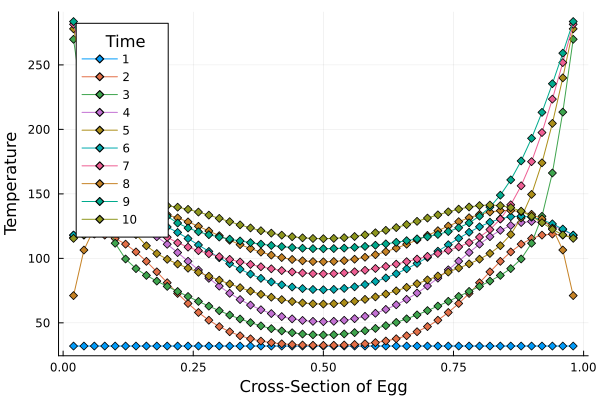

In [843]:
p1 = Plots.plot(ylabel="Temperature", xlabel="Cross-Section of Egg", legend_title="Time")
for (idx, tvec) in enumerate(sol.u[1:Integer(floor(N_t//10)):N_t])
    Plots.plot!(zf[2:end-1], tvec[2:end-1], label = idx, markershape = :diamond)
end
p1

In [ ]:
using Statistics
median

median (generic function with 7 methods)

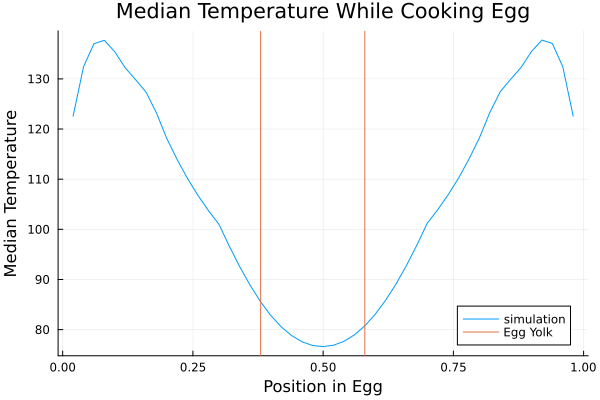

In [844]:
# Plots.plot!(zf[2:end-1], tvec[2:end-1], label = idx, markershape = :diamond)
plot(zf[2:end-1], median(hcat(sol.u...)[2:end-1, :]; dims=2), label="simulation", ylabel="Median Temperature", title="Median Temperature While Cooking Egg", xlabel="Position in Egg")

vline!(zf[[1 + div(n - 1, 2) - div(n_yolk, 2), 1 + div(n - 1, 2) + div(n_yolk, 2)]], label="Egg Yolk")

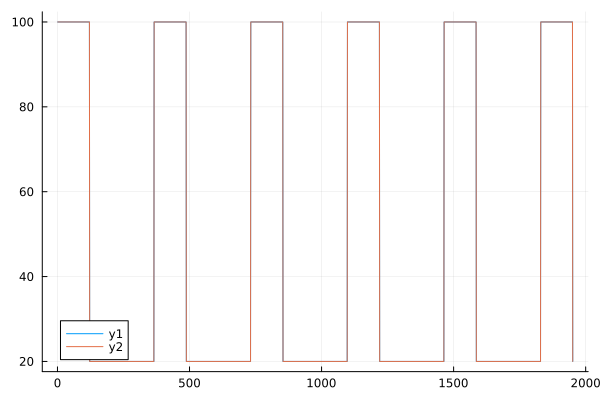

In [845]:
Plots.plot(hcat(sol.u...)[1, :])
Plots.plot!(hcat(sol.u...)[n+1, :])

# Plots.plot!(hcat(sol.u...)[2, :], label="albumen", color=:grey)

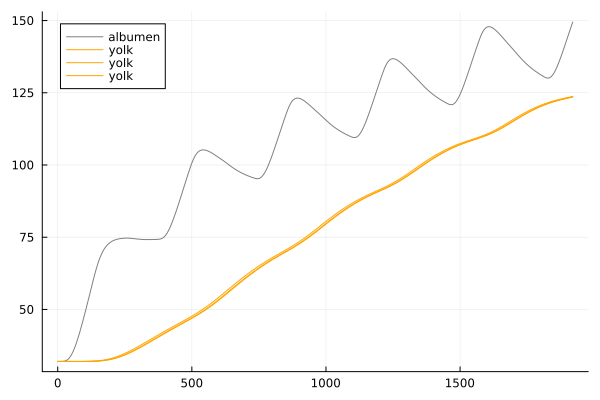

In [846]:
Plots.plot()

# 
# Plots.plot!(hcat(sol.u...)[2, :], label="albumen", color=:grey)
# Plots.plot!(sol.t, hcat(sol.u...)[3, :], label="albumen", color=:grey)
# Plots.plot!(sol.t, hcat(sol.u...)[4, :], label="albumen", color=:grey)
Plots.plot!(sol.t, hcat(sol.u...)[Integer(floor(n/4)), :], label="albumen", color=:grey)
# Plots.plot!(hcat(sol.u...)[5, :], label="albumen", color=:grey)
# Plots.plot!(hcat(sol.u...)[Integer(floor(n/2)) - 2, :], label="yolk", color=:orange)
Plots.plot!(sol.t, hcat(sol.u...)[Integer(floor(n/2)) - 1, :], label="yolk", color=:orange)
Plots.plot!(sol.t, hcat(sol.u...)[Integer(floor(n/2)) + 0, :], label="yolk", color=:orange)
Plots.plot!(sol.t, hcat(sol.u...)[Integer(floor(n/2)) + 1, :], label="yolk", color=:orange)
# Plots.plot!(hcat(sol.u...)[Integer(floor(n/2)) + 2, :], label="yolk", color=:orange)
# Plots.plot!(hcat(sol.u...)[n-3, :], label="albumen", color=:black)
# Plots.plot!(sol.t, hcat(sol.u...)[n-2, :], label="albumen", color=:black)
# Plots.plot!(sol.t, hcat(sol.u...)[n-1, :], label="albumen", color=:black)
# Plots.plot!(hcat(sol.u...)[n, :], label="albumen", color=:black)


In [ ]:
pulsed = hcat(sol.u...)[Integer(floor(n/2)) + 0, :]
pulsed_time = sol.t

1951-element Vector{Float64}:
    0.0
    1.0005211047420532
    2.0010422094841065
    3.0015633142261593
    4.002084418968213
    5.002605523710265
    6.003126628452319
    7.003647733194372
    8.004168837936426
    9.004689942678478
   10.00521104742053
   11.005732152162585
   12.006253256904637
    ⋮
 1909.9947889525795
 1910.9953100573216
 1911.9958311620635
 1912.9963522668056
 1913.9968733715477
 1914.9973944762896
 1915.9979155810317
 1916.9984366857739
 1917.998957790516
 1918.9994788952579
 1920.0
 1920.0

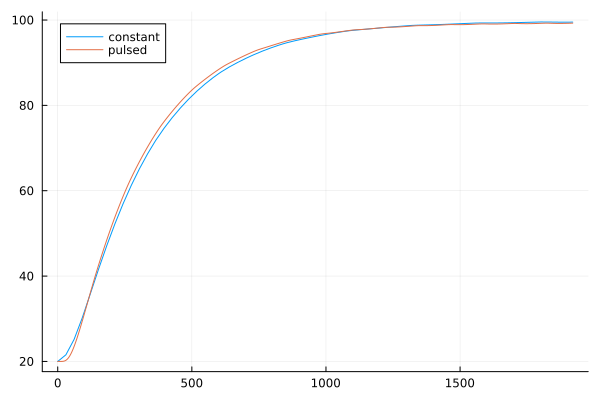

In [ ]:
Plots.plot(constant_time, constant, label="constant")
Plots.plot!(pulsed_time, pulsed, label="pulsed")

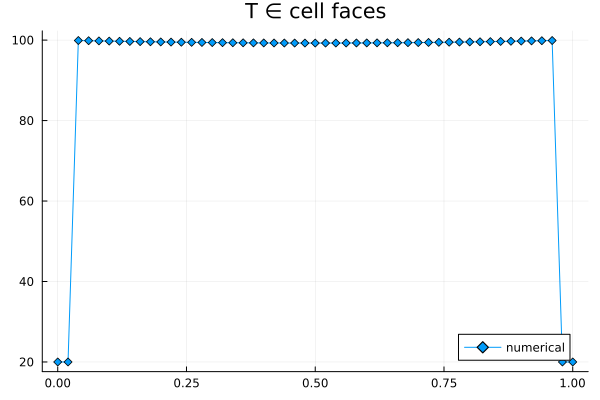

In [ ]:
T_end = sol.u[end]

# p1 = Plots.plot(zf, T_analytic.(zf), label = "analytic", markershape = :circle,
#     markersize = 6)
p1 = Plots.plot()
p1 = Plots.plot!(p1, zf, T_end, label = "numerical", markershape = :diamond)
p1 = Plots.plot!(p1, title = "T ∈ cell faces")

# p2 = Plots.plot(zf, abs.(T_end .- T_analytic.(zf)), label = "error", markershape = :circle,
#     markersize = 6)
# p2 = Plots.plot!(p2, title = "T ∈ cell faces")

# Plots.plot(p1, p2)

In [ ]:
# using PyPlot
# T_end = sol.u[end]

# fig, ax = plt.subplots(1, 2, figsize=(8, 3.5))

# ax[1].plot(zf, T_analytic.(zf), label = "analytic", markershape = :circle,
#     markersize = 6)
# ax[1].plot(p1, zf, T_end, label = "numerical", markershape = :diamond)
# ax[1].plot(p1, title = "T ∈ cell faces")

# ax[2].plot(zf, abs.(T_end .- T_analytic.(zf)), label = "error", markershape = :circle,
#     markersize = 6)
# ax[2].plot(p2, title = "T ∈ cell faces")

# plt.show()
# # plt.plot(p1, p2)